<a href="https://colab.research.google.com/github/gargleblaster/quantunafraid/blob/main/Trade_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Initialization

In [ ]:
!unzip tradeHistoryDump.zip

Archive:  tradeHistoryDump.zip
  inflating: closedpositions.csv     
  inflating: trades.csv              
  inflating: storedtradeplans.csv    


In [ ]:
#####Unzipping Files
import zipfile
import shutil
import os
import pandas as pd
import pytz

z_folder = '.'
cwd = os.getcwd()
dir_to_unzip = os.path.join(cwd, z_folder)
#print(dir_to_unzip)
def unzipDir(dir_name, verbose=False):
    for name in os.listdir(dir_name):
        path = os.path.join(dir_name, name)
        if os.path.isfile(path) and path.endswith('.zip'):
            if verbose:
                print('Unzipping', path)
            with zipfile.ZipFile(path, 'r') as zip_ref:
                zip_ref.extractall(dir_name)

unzipDir(dir_to_unzip, verbose=True)

########## Putting files into dataframes
dfs = {}
def make_dfs(dir_name):
    for currfile in os.listdir(dir_name):
        path = os.path.join(dir_name, currfile)
        if os.path.isfile(path) and path.endswith('.csv'):
            print(currfile)
            date_columns = []
            timezone = pytz.timezone('America/New_York')
            match currfile:
                case 'trades.csv':
                    date_columns = ['transaction_date']
                case 'closedpositions.csv':
                    date_columns = ['entrydate', 'closedate']
            currdf = pd.read_csv(path, index_col=None, header=0, parse_dates=date_columns)

            # Localize the datetime columns to Eastern Time
            for date_column in date_columns:
                currdf[date_column] = currdf[date_column].dt.tz_localize(timezone)

            dfs[currfile] = currdf

make_dfs(dir_to_unzip)

#######Loading dataframes into sql tables
import sqlite3
from sqlite3 import Error
from pandas import DataFrame

def create_conn(path):
    conn = None
    try:
        conn = sqlite3.connect(path)
        print("Connection successful")
    except Error as e:
            print("The error % occurred.".format(e))
    return conn

conn = create_conn('database.db')
c = conn.cursor()

def convertDFtoSQL(df_name):
    print(df_name)
    #df_name='df_movie_budgets'
    df = dfs[df_name]
    cols = str(list(df.columns))[1:-1]
    createString = 'CREATE TABLE '+ df_name + '(' + cols + ')'
    print(createString)
    try:
        c.execute(createString)
    except:
        pass
    df.to_sql(df_name, conn, if_exists='replace', index=False)

    con = sqlite3.connect('database.db')
    cursor = con.cursor()
    cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")
    print(cursor.fetchall())

    c.execute(f'SELECT * FROM "{df_name}"')
    #Checking that it came through
    dfOut = pd.DataFrame(c.fetchall())
    dfOut.columns = [i[0] for i in c.description]
    print(df_name)
    display(dfOut.head(4))
    c.execute(f'SELECT count(*) FROM "{df_name}"')
    print(c.fetchall())

for df in dfs.keys():
    convertDFtoSQL(df)

import numpy as np
frame = dfs['closedpositions.csv']
#frame2 = pd.merge(dfs['closedpositions.csv'], dfs['trades.csv'], on='tradingsystemid', how='left')


# TODO join trades with closedpositions

Unzipping /content/./tradeHistoryDump.zip
storedtradeplans.csv
closedpositions.csv
trades.csv
Connection successful
storedtradeplans.csv
CREATE TABLE storedtradeplans.csv('id', 'json')
[('storedtradeplans.csv',)]
storedtradeplans.csv


,id,json
0,1627414544359,"{""id"":1627414544359,""status"":""ARMED"",""brokerag..."
1,1631193615290,"{""id"":1631193615290,""status"":""ARMED"",""brokerag..."
2,1631710073443,"{""id"":1631710073443,""status"":""ARMED"",""brokerag..."
3,1660743439781,"{""id"":1660743439781,""status"":""ARMED"",""brokerag..."


[(10426,)]
closedpositions.csv
CREATE TABLE closedpositions.csv('accountid', 'tradingsystemid', 'symbol', 'side', 'costbasis', 'quantity', 'realizedpnl', 'entrydate', 'closedate', 'positiontype', 'strategy', 'percent_pnl', 'entrycostbasis', 'key', 'strategydescription', 'tradeplantemplate', 'tradeplanid')
[('storedtradeplans.csv',), ('closedpositions.csv',)]
closedpositions.csv


,accountid,tradingsystemid,symbol,side,costbasis,quantity,realizedpnl,entrydate,closedate,positiontype,strategy,percent_pnl,entrycostbasis,key,strategydescription,tradeplantemplate,tradeplanid
0,BACKTEST,BASIC_TRADING_SYSTEM1627414491524,TTD,sell_short,0,10,-0.30,2021-07-27 15:36:09-04:00,2021-07-27 15:37:03-04:00,equity,CANDLE_PATTERN,-0.036381,824.6,BASIC_TRADING_SYSTEM1627414491524|TTD|BASIC_TR...,BREAK_LOW-BREAK_LOW,candlePatternSimLong,NaN
1,BACKTEST,BASIC_TRADING_SYSTEM1627414491518,FB210730P00367500,buy,0,10,-150.00,2021-07-27 15:35:05-04:00,2021-07-27 15:37:10-04:00,option,CANDLE_PATTERN,-1.435407,10450.0,BASIC_TRADING_SYSTEM1627414491518|FB210730P003...,None,candlePatternSimLong,NaN
2,BACKTEST,BASIC_TRADING_SYSTEM1627414491517,FB210730P00367500,buy,0,10,-150.00,2021-07-27 15:35:05-04:00,2021-07-27 15:37:11-04:00,option,CANDLE_PATTERN,-1.435407,10450.0,BASIC_TRADING_SYSTEM1627414491517|FB210730P003...,BREAK_LOW-BREAK_LOW,candlePatternSimLong,NaN
3,BACKTEST,BASIC_TRADING_SYSTEM1627414491522,AAPL,buy,0,10,0.02,2021-07-27 15:36:39-04:00,2021-07-27 15:37:11-04:00,equity,CANDLE_PATTERN,0.001365,1464.9,BASIC_TRADING_SYSTEM1627414491522|AAPL|BASIC_T...,BREAK_LOW-BREAK_HIGH,candlePatternSimLong,NaN


[(148137,)]
trades.csv
CREATE TABLE trades.csv('orderid', 'accountid', 'brokerage', 'tradingsystemid', 'operatingmode', 'classtype', 'ordertype', 'symbol', 'side', 'avg_fill_price', 'quantity', 'transaction_date', 'websocketconnection', 'hostaddress', 'metrics')
[('storedtradeplans.csv',), ('closedpositions.csv',), ('trades.csv',)]
trades.csv


,orderid,accountid,brokerage,tradingsystemid,operatingmode,classtype,ordertype,symbol,side,avg_fill_price,quantity,transaction_date,websocketconnection,hostaddress,metrics
0,BASIC_TRADING_SYSTEM16274144915171,BACKTEST,BACKTEST,BASIC_TRADING_SYSTEM1627414491517,backtesting,option,market,FB210730P00367500,buy,10.45,10,2021-07-27 15:35:05-04:00,/24.98.122.227:57732,None,"{""quoteAtOrderPlacement"":{""time"":0,""symbol"":""F..."
1,BASIC_TRADING_SYSTEM16274144915182,BACKTEST,BACKTEST,BASIC_TRADING_SYSTEM1627414491518,backtesting,option,market,FB210730P00367500,buy,10.45,10,2021-07-27 15:35:05-04:00,/24.98.122.227:57732,None,None
2,BASIC_TRADING_SYSTEM16274144915249,BACKTEST,BACKTEST,BASIC_TRADING_SYSTEM1627414491524,backtesting,equity,market,TTD,sell_short,82.46,10,2021-07-27 15:36:09-04:00,/24.98.122.227:57732,None,"{""quoteAtOrderPlacement"":{""time"":0,""symbol"":""T..."
3,BASIC_TRADING_SYSTEM162741449152310,BACKTEST,BACKTEST,BASIC_TRADING_SYSTEM1627414491523,backtesting,equity,market,TTD,sell_short,82.46,10,2021-07-27 15:36:09-04:00,/24.98.122.227:57732,None,None


[(587933,)]


In [ ]:
!pip install jupyter_dash seaborn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 31.2 MB/s eta 0:00:00


In [ ]:
frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 148137 entries, 0 to 148136
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype                           
---  ------               --------------   -----                           
 0   accountid            148137 non-null  object                          
 1   tradingsystemid      148137 non-null  object                          
 2   symbol               148137 non-null  object                          
 3   side                 148137 non-null  object                          
 4   costbasis            148137 non-null  int64                           
 5   quantity             148137 non-null  int64                           
 6   realizedpnl          148137 non-null  float64                         
 7   entrydate            148137 non-null  datetime64[ns, America/New_York]
 8   closedate            148137 non-null  datetime64[ns, America/New_York]
 9   positiontype         148137 non-null  object    

In [ ]:
# reusable code
import re

def extract_underlying_stock_symbol(symbol):
    pattern = r'^([A-Z]+)'
    match = re.match(pattern, symbol)
    if match:
        return match.group(1)
    else:
        raise ValueError("Invalid symbol format.")

# Overview

## Overall PnL

In [ ]:
frame['realizedpnl'].sum()

-287938.87

## Normalized expectancies

In [ ]:
# winrate and expectancy by symbol and tradeplan - normalized
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0
df["pct_pnl"] = df['realizedpnl'] / df['entrycostbasis'] * 100

grouped = df.groupby(['underlying', 'tradeplantemplate'])
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['pct_pnl'].sum()
  losses = grp[grp['isLoser']]['pct_pnl'].sum()
  avgwin = avglos = wlratio = 0.0
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  maxwin = grp[grp['isWinner']]['pct_pnl'].max()
  maxlos = grp[grp['isLoser']]['pct_pnl'].min()
  row = {'name': name, 'maxwin': maxwin, 'maxloss': maxlos, 'trades': wincount+loscount, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,maxwin,maxloss,trades,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
63,"(NVDA, Follow outside candles OPTIONS)",10.011001,NaN,2,2,0,1.000000,17.719334,0.000000,8.859667,0.000000,1.000000,8.859667
64,"(NVDA, Follow outside candles OPTIONS Filter 15)",10.011001,NaN,2,2,0,1.000000,11.934078,0.000000,5.967039,0.000000,1.000000,5.967039
166,"(XOM, candlePatternSimLong)",4.672897,NaN,1,1,0,1.000000,4.672897,0.000000,4.672897,0.000000,1.000000,4.672897
104,"(SPY, MultiEMA S v1)",42.252964,-11.764706,44,19,25,0.431818,326.948911,-135.586539,17.207837,-5.423462,3.172851,4.349145
140,"(SPY, otm1)",9.731544,-0.375235,10,8,2,0.800000,30.494258,-0.571698,3.811782,-0.285849,13.334947,2.992256
66,"(NVDA, Reversals v1)",5.119826,NaN,2,2,0,1.000000,5.921831,0.000000,2.960915,0.000000,1.000000,2.960915
83,"(QQQ, Scalp outside candles OPTIONS)",12.288401,-5.280528,24,16,8,0.666667,75.840103,-20.200358,4.740006,-2.525045,1.877197,2.318323
62,"(NVAX, CandleMagStockLong)",1.416048,NaN,1,1,0,1.000000,1.416048,0.000000,1.416048,0.000000,1.000000,1.416048
142,"(SPY, spyTemplate)",1.318458,NaN,1,1,0,1.000000,1.318458,0.000000,1.318458,0.000000,1.000000,1.318458
143,"(SPY, spyTemplateDemo)",10.317460,-2.933985,4,1,3,0.250000,10.317460,-5.466240,10.317460,-1.822080,5.662463,1.212805


Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


In [ ]:
# winrate and expectancy by tradeplan -- normalized
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0
df["pct_pnl"] = df['realizedpnl'] / df['entrycostbasis'] * 100

grouped = df.groupby('tradeplantemplate')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['pct_pnl'].sum()
  losses = grp[grp['isLoser']]['pct_pnl'].sum()
  avgwin = avglos = 0.0
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  maxwin = grp[grp['isWinner']]['pct_pnl'].max()
  maxlos = grp[grp['isLoser']]['pct_pnl'].min()
  row = {'name': name, 'maxwin': maxwin, 'maxloss': maxlos, 'trades': wincount+loscount, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,maxwin,maxloss,trades,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
14,MultiEMA S v1,42.252964,-11.764706,44,19,25,0.431818,326.948911,-135.586539,17.207837,-5.423462,3.172851,4.349145
54,spyTemplate,1.318458,NaN,1,1,0,1.000000,1.318458,0.000000,1.318458,0.000000,1.000000,1.318458
55,spyTemplateDemo,10.317460,-2.933985,4,1,3,0.250000,10.317460,-5.466240,10.317460,-1.822080,5.662463,1.212805
29,SPY scalp 15,10.379242,-4.477612,17,8,9,0.470588,43.853699,-27.010806,5.481712,-3.001201,1.826506,0.990758
3,CandleMagStockLong,1.416048,-0.093744,2,1,1,0.500000,1.416048,-0.093744,1.416048,-0.093744,15.105486,0.661152
27,SPY 15 EMA short,8.313539,-4.587156,9,5,4,0.555556,20.482837,-16.618952,4.096567,-4.154738,0.985999,0.429321
30,SPY scalp 5,6.283069,-12.352941,29,14,15,0.482759,48.507438,-39.343538,3.464817,-2.622903,1.320986,0.315997
13,MultiEMA L v1,34.207342,-16.250000,57,21,36,0.368421,234.690226,-221.636478,11.175725,-6.156569,1.815252,0.229013
41,Scalp1,0.642077,-0.275484,8,5,3,0.625000,1.352493,-0.414790,0.270499,-0.138263,1.956401,0.117213
16,Outside v1.1,20.987654,-12.809917,2458,1292,1166,0.525631,3751.724826,-3667.771541,2.903812,-3.145602,0.923134,0.034155


In [ ]:
# winrate and expectancy by symbol -- normalized
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0
df["pct_pnl"] = df['realizedpnl'] / df['entrycostbasis'] * 100

grouped = df.groupby('underlying')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['pct_pnl'].sum()
  losses = grp[grp['isLoser']]['pct_pnl'].sum()
  avgwin = avglos = 0.0
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  maxwin = grp[grp['isWinner']]['pct_pnl'].max()
  maxlos = grp[grp['isLoser']]['pct_pnl'].min()
  row = {'name': name, 'maxwin': maxwin, 'maxloss': maxlos, 'trades': wincount+loscount, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,maxwin,maxloss,trades,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
19,JPM,27.950311,NaN,2,2,0,1.000000,29.380926,0.000000,14.690463,0.000000,1.000000,14.690463
20,KRE,12.280702,NaN,1,1,0,1.000000,12.280702,0.000000,12.280702,0.000000,1.000000,12.280702
18,JNJ,7.109005,NaN,1,1,0,1.000000,7.109005,0.000000,7.109005,0.000000,1.000000,7.109005
38,USO,5.355080,NaN,1,1,0,1.000000,5.355080,0.000000,5.355080,0.000000,1.000000,5.355080
31,SNOW,4.597701,NaN,1,1,0,1.000000,4.597701,0.000000,4.597701,0.000000,1.000000,4.597701
23,MDB,2.429245,NaN,1,1,0,1.000000,2.429245,0.000000,2.429245,0.000000,1.000000,2.429245
28,NVAX,1.416048,NaN,2,2,0,1.000000,1.416048,0.000000,0.708024,0.000000,1.000000,0.708024
13,FNGU,0.642077,NaN,1,1,0,1.000000,0.642077,0.000000,0.642077,0.000000,1.000000,0.642077
27,NFLX,1.382488,-0.212856,2,1,1,0.500000,1.382488,-0.212856,1.382488,-0.212856,6.494947,0.584816
32,SPY,42.403905,-51.214575,48521,20258,28263,0.417510,85730.588041,-75107.715866,4.231937,-2.657457,1.592476,0.218933


In [ ]:
# winrate and expectancy by instrument -- normalized
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0
df["pct_pnl"] = df['realizedpnl'] / df['entrycostbasis'] * 100
# Define the conditions and choices
conditions = [
    (df['side'] == 'buy') & (df['symbol'].str.contains('C\d+$', regex=True)),
    (df['side'] == 'sell') & (df['symbol'].str.contains('C\d+$', regex=True)),
    (df['side'] == 'buy') & (df['symbol'].str.contains('P\d+$', regex=True)),
    (df['side'] == 'sell') & (df['symbol'].str.contains('P\d+$', regex=True)),
    (df['side'] == 'buy') & (~df['symbol'].str.contains('[CP]\d+$', regex=True)),
    (df['side'] == 'sell_short') & (~df['symbol'].str.contains('[CP]\d+$', regex=True))
]

choices = ['LongCall', 'ShortCall', 'LongPut', 'ShortPut', 'LongShares', 'ShortShares']

# Apply the conditions and choices
df['instrument'] = np.select(conditions, choices, default='Unknown')

grouped = df.groupby('instrument')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['pct_pnl'].sum()
  losses = grp[grp['isLoser']]['pct_pnl'].sum()
  avgwin = avglos = 0.0
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  maxwin = grp[grp['isWinner']]['pct_pnl'].max()
  maxlos = grp[grp['isLoser']]['pct_pnl'].min()
  row = {'name': name, 'maxwin': maxwin, 'maxloss': maxlos, 'trades': wincount+loscount, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,maxwin,maxloss,trades,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
2,LongShares,1.339157,-0.839568,771,377,394,0.488975,22.143167,-19.318489,0.058735,-0.049032,1.197902,0.003664
3,ShortShares,1.416048,-1.156255,293,98,195,0.334471,9.766915,-15.642204,0.099662,-0.080216,1.242419,-0.020052
1,LongPut,93.254707,-52.500000,73169,29363,43806,0.401304,128803.580843,-131403.098768,4.386595,-2.999660,1.462364,-0.035528
0,LongCall,74.959416,-100.000000,73461,29585,43876,0.402731,120769.431087,-125353.163360,4.082117,-2.856987,1.428819,-0.062397
4,Unknown,59.616749,-72.413793,443,199,244,0.449210,1145.219162,-1348.507886,5.754870,-5.526672,1.041290,-0.458891


## Non-normalized expectancies

In [ ]:
# winrate and expectancy by symbol and tradeplan
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0

grouped = df.groupby(['underlying', 'tradeplantemplate'])
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['realizedpnl'].sum()
  losses = grp[grp['isLoser']]['realizedpnl'].sum()
  avgwin = avglos = 0.0
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  maxwin = grp[grp['isWinner']]['realizedpnl'].max()
  maxlos = grp[grp['isLoser']]['realizedpnl'].min()
  row = {'name': name, 'maxwin': maxwin, 'maxloss': maxlos, 'trades': wincount+loscount, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,maxwin,maxloss,trades,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
63,"(NVDA, Follow outside candles OPTIONS)",455.00,NaN,2,2,0,1.000000,825.00,0.00,412.500000,0.000000,1.000000,412.500000
64,"(NVDA, Follow outside candles OPTIONS Filter 15)",455.00,NaN,2,2,0,1.000000,530.00,0.00,265.000000,0.000000,1.000000,265.000000
66,"(NVDA, Reversals v1)",235.00,NaN,2,2,0,1.000000,267.00,0.00,133.500000,0.000000,1.000000,133.500000
140,"(SPY, otm1)",290.00,-20.00,10,8,2,0.800000,1240.00,-30.00,155.000000,-15.000000,10.333333,121.000000
83,"(QQQ, Scalp outside candles OPTIONS)",588.00,-256.00,24,16,8,0.666667,3675.00,-984.00,229.687500,-123.000000,1.867378,112.125000
104,"(SPY, MultiEMA S v1)",1069.00,-296.00,44,19,25,0.431818,7978.00,-3325.00,419.894737,-133.000000,3.157103,105.750000
62,"(NVAX, CandleMagStockLong)",82.06,NaN,1,1,0,1.000000,82.06,0.00,82.060000,0.000000,1.000000,82.060000
166,"(XOM, candlePatternSimLong)",50.00,NaN,1,1,0,1.000000,50.00,0.00,50.000000,0.000000,1.000000,50.000000
85,"(QQQ, Scalp outside v3)",404.00,-345.00,56,29,27,0.517857,4809.00,-2857.00,165.827586,-105.814815,1.567149,34.857143
115,"(SPY, Reversals v1)",1152.00,-624.00,252,113,139,0.448413,32380.00,-25512.00,286.548673,-183.539568,1.561236,27.253968


In [ ]:
# winrate and expectancy by tradeplan
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0

grouped = df.groupby('tradeplantemplate')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['realizedpnl'].sum()
  losses = grp[grp['isLoser']]['realizedpnl'].sum()
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  row = {'name': name, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)
pd.set_option('display.max_rows', None)
sorted_stats

,name,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
14,MultiEMA S v1,19,25,0.431818,7978.00,-3325.00,419.894737,-133.000000,3.157103,105.750000
3,CandleMagStockLong,1,1,0.500000,82.06,-6.08,82.060000,-6.080000,13.496711,37.990000
54,spyTemplate,1,0,1.000000,26.00,0.00,26.000000,-60.000000,0.433333,26.000000
55,spyTemplateDemo,1,3,0.250000,195.00,-98.00,195.000000,-32.666667,5.969388,24.250000
29,SPY scalp 15,8,9,0.470588,565.00,-311.00,70.625000,-34.555556,2.043810,14.941176
13,MultiEMA L v1,21,36,0.368421,5754.00,-5422.00,274.000000,-150.611111,1.819255,5.824561
30,SPY scalp 5,14,15,0.482759,678.00,-543.00,48.428571,-36.200000,1.337806,4.655172
26,SPY 15 EMA long,6,9,0.400000,417.00,-369.00,69.500000,-41.000000,1.695122,3.200000
41,Scalp1,5,3,0.625000,107.25,-83.61,21.450000,-27.870000,0.769645,2.955000
5,Demo CandleBrk 3Jun2022,29,38,0.432836,817.95,-728.33,28.205172,-19.166579,1.471581,1.337612


In [ ]:
# winrate and expectancy by symbol
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0

grouped = df.groupby('underlying')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['realizedpnl'].sum()
  losses = grp[grp['isLoser']]['realizedpnl'].sum()
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  row = {'name': name, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)

pd.set_option('display.max_rows', None)         # Set the display option to show all rows
sorted_stats

,name,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
23,MDB,1,0,1.000000,103.00,0.00,103.000000,-0.650000,158.461538,103.000000
20,KRE,1,0,1.000000,84.00,0.00,84.000000,-93.598194,0.897453,84.000000
31,SNOW,1,0,1.000000,80.00,0.00,80.000000,-93.715988,0.853643,80.000000
19,JPM,2,0,1.000000,145.00,0.00,72.500000,-93.598194,0.774588,72.500000
18,JNJ,1,0,1.000000,45.00,0.00,45.000000,-93.598194,0.480779,45.000000
28,NVAX,2,0,1.000000,82.06,0.00,41.030000,-10.310000,3.979631,41.030000
38,USO,1,0,1.000000,38.02,0.00,38.020000,-0.455000,83.560440,38.020000
13,FNGU,1,0,1.000000,7.05,0.00,7.050000,-14.810000,0.476030,7.050000
32,SPY,20258,28263,0.417510,2660211.66,-2327889.35,131.316599,-82.365260,1.594320,6.849041
30,QQQ,20169,28222,0.416792,2767406.05,-2644852.61,137.210871,-93.715988,1.464114,2.532567


In [ ]:
# winrate and expectancy by instrument
df = frame.copy()

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df["isWinner"] = df['realizedpnl'] >= 0
df["isLoser"] = df['realizedpnl'] < 0
# Define the conditions and choices
conditions = [
    (df['side'] == 'buy') & (df['symbol'].str.contains('C\d+$', regex=True)),
    (df['side'] == 'sell') & (df['symbol'].str.contains('C\d+$', regex=True)),
    (df['side'] == 'buy') & (df['symbol'].str.contains('P\d+$', regex=True)),
    (df['side'] == 'sell') & (df['symbol'].str.contains('P\d+$', regex=True)),
    (df['side'] == 'buy') & (~df['symbol'].str.contains('[CP]\d+$', regex=True)),
    (df['side'] == 'sell_short') & (~df['symbol'].str.contains('[CP]\d+$', regex=True))
]

choices = ['LongCall', 'ShortCall', 'LongPut', 'ShortPut', 'LongShares', 'ShortShares']

# Apply the conditions and choices
df['instrument'] = np.select(conditions, choices, default='Unknown')

grouped = df.groupby('instrument')
stats = pd.DataFrame()
for name, grp in grouped:
  wincount = grp['isWinner'].values.sum()
  loscount = grp['isLoser'].values.sum()
  winrate = wincount / (wincount+loscount)
  profits = grp[grp['isWinner']]['realizedpnl'].sum()
  losses = grp[grp['isLoser']]['realizedpnl'].sum()
  if wincount != 0:
    avgwin = profits/wincount
  if loscount != 0:
    avglos = losses/loscount
  wlratio = abs(avgwin / avglos) if avglos != 0 else 1.0
  expectancy = winrate * avgwin + (1.0 - winrate) * avglos
  row = {'name': name, 'wincount': wincount, 'losscount': loscount, 'winrate': winrate, 'profits': profits, 'losses': losses, 'avgwin': avgwin, 'avgloss': avglos, 'wl ratio':wlratio, 'expectancy': expectancy}
  stats = pd.concat([stats, pd.DataFrame([row])], ignore_index=True)

sorted_stats = stats.sort_values(by='expectancy', ascending=False)

pd.set_option('display.max_rows', None)         # Set the display option to show all rows
sorted_stats

,name,wincount,losscount,winrate,profits,losses,avgwin,avgloss,wl ratio,expectancy
2,LongShares,377,394,0.488975,5113.55,-4471.22,13.563793,-11.348274,1.195230,0.833113
1,LongPut,29363,43806,0.401304,4083240.00,-4213262.00,139.060723,-96.180021,1.445838,-1.777009
0,LongCall,29585,43876,0.402731,3850593.00,-4002569.00,130.153558,-91.224565,1.426738,-2.068798
3,ShortShares,98,195,0.334471,2277.23,-3422.52,23.237041,-17.551385,1.323943,-3.908840
4,Unknown,199,244,0.449210,10407.03,-15844.94,52.296633,-64.938279,0.805328,-12.275192


In [ ]:
pd.reset_option('display.max_rows')              # restore pandas display mode

# Trades by Time

In [ ]:
# scatter of pnl by time of day

import pandas as pd
import numpy as np
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.graph_objects as go
import plotly.express as px
import plotly.subplots as sp
import seaborn as sns
from jupyter_dash import JupyterDash
from dash import dcc
from dash import html
from dash.dependencies import Input, Output
import datetime

df = frame.copy()
df.drop(['side', 'strategy', 'strategydescription'], axis=1, inplace=True)

df['time_of_day'] = df['entrydate'].dt.time
df['time_of_day_num'] = df['time_of_day'].apply(lambda x: x.hour * 3600 + x.minute * 60 + x.second)
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

byTimeOfDay = df.sort_values(by='time_of_day_num')
tod = byTimeOfDay['time_of_day']
pnl = byTimeOfDay["realizedpnl"]

# create scatter plot
fig = px.scatter(df, x=tod, y=pnl, #color='underlying', hover_data=['entrydate','realizedpnl'],
                 labels={"x": "Time of Day", "y": "P&L",}, title="Trades by Time of Day")
fig.show()

In [ ]:
# scatter of pnl by time of day

import pandas as pd
import numpy as np
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.graph_objects as go
import plotly.express as px
import plotly.subplots as sp
import seaborn as sns
from jupyter_dash import JupyterDash
from dash import dcc
from dash import html
from dash.dependencies import Input, Output
import datetime

df = frame.copy()
df.drop(['side', 'strategy', 'strategydescription'], axis=1, inplace=True)

df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))
df['time_of_day'] = df['entrydate'].dt.time
df['time_of_day_num'] = df['time_of_day'].apply(lambda x: x.hour * 3600 + x.minute * 60 + x.second)

df.sort_values(by='time_of_day_num', inplace=True)

tod = df['time_of_day']
pnl = df["realizedpnl"]

# NOTE due to a bug in plotly, we cannot display the x-axis as actual time of day, or the plot will cycle through time of day incorrectly

#fig = px.scatter(df, x='time_of_day', y='time_of_day_num', color='underlying', hover_data=['entrydate','realizedpnl'])
fig = px.scatter(df, x='time_of_day_num', y='realizedpnl', color='underlying', hover_data=['entrydate','realizedpnl'])
fig.show()

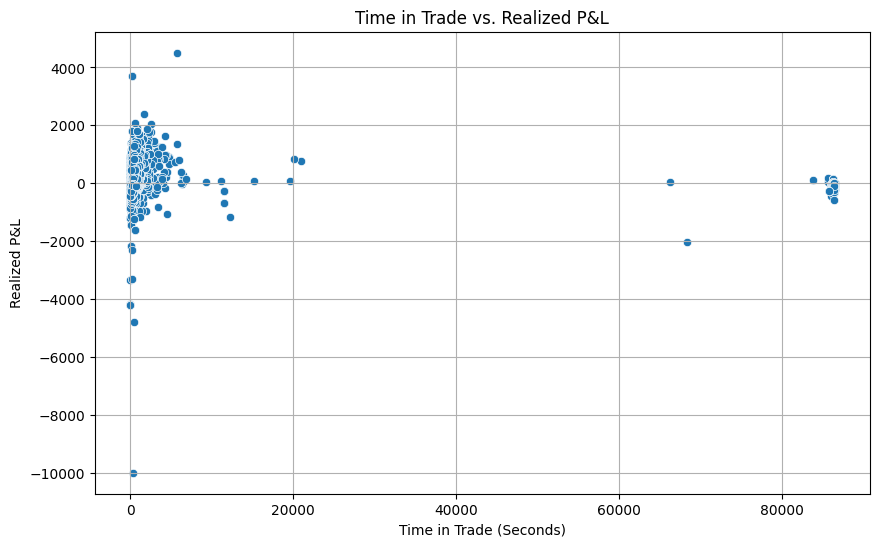

Correlation coefficient between time in trade and realized P&L: 0.01313211092658507


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = frame.copy()

# Ensure 'entrydate' and 'closedate' are in datetime format
df['entrydate'] = pd.to_datetime(df['entrydate'])
df['closedate'] = pd.to_datetime(df['closedate'])

# Compute Time-in-Trade as the number of days between 'closedate' and 'entrydate'
df['time_in_trade'] = (df['closedate'] - df['entrydate']).dt.seconds

plt.figure(figsize=(10, 6))
sns.scatterplot(x='time_in_trade', y='realizedpnl', data=df)

plt.title('Time in Trade vs. Realized P&L')
plt.xlabel('Time in Trade (Seconds)')
plt.ylabel('Realized P&L')
plt.grid(True)
plt.show()

# Calculate and print the correlation coefficient
correlation = df[['time_in_trade', 'realizedpnl']].corr().iloc[0, 1]
print(f"Correlation coefficient between time in trade and realized P&L: {correlation}")


In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px

df = frame.copy()
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

# Ensure 'entrydate' and 'closedate' are in datetime format
df['entrydate'] = pd.to_datetime(df['entrydate'])
df['closedate'] = pd.to_datetime(df['closedate'])

# Compute Time-in-Trade as the number of days between 'closedate' and 'entrydate'
df['time_in_trade'] = (df['closedate'] - df['entrydate']).dt.seconds

# Create an interactive scatter plot with Plotly
fig = px.scatter(df, x='time_in_trade', y='realizedpnl',
                 hover_data=['underlying', 'tradeplantemplate', 'entrydate', 'closedate', 'realizedpnl'],
                 title='Time in Trade vs. Realized P&L',
                 labels={'time_in_trade': 'Time in Trade (Seconds)', 'realizedpnl': 'Realized P&L'})

fig.show()

# Calculate and print the correlation coefficient
correlation = df[['time_in_trade', 'realizedpnl']].corr().iloc[0, 1]
print(f"Correlation coefficient between time in trade and realized P&L: {correlation}")


Correlation coefficient between time in trade and realized P&L: 0.01313211092658507


# PnL Heatmaps

underlying                                    AAPL       AMC      AMZN  \
tradeplantemplate                                                        
2-min Green                                    NaN       NaN       NaN   
2-min Red                                      NaN       NaN       NaN   
AMZN Scalp1                                    NaN       NaN -0.002456   
CandleMagStockLong                             NaN       NaN       NaN   
Demo 3Jun2022                                  NaN       NaN       NaN   
Demo CandleBrk 3Jun2022                        NaN       NaN       NaN   
EMA Bounce                                     NaN       NaN       NaN   
Follow outside candles                         NaN       NaN       NaN   
Follow outside candles OPTIONS           -2.579363       NaN -3.483144   
Follow outside candles OPTIONS Filter 15 -1.365276       NaN -2.052074   
Follow outside candles TSLA                    NaN       NaN       NaN   
GS-CandleBreak1                       

<Axes: xlabel='underlying', ylabel='tradeplantemplate'>

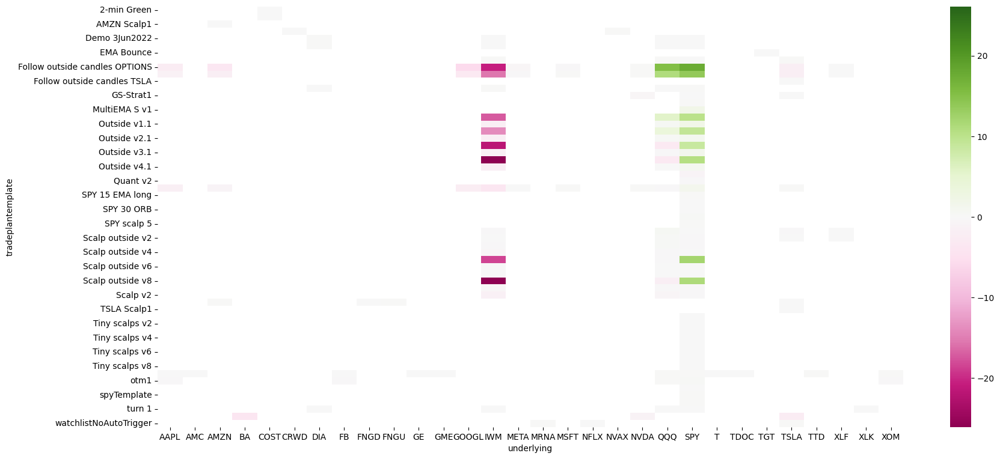

In [ ]:
# TODO normalized not working yet

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.graph_objects as go
import plotly.express as px
import plotly.subplots as sp
import seaborn as sns
from jupyter_dash import JupyterDash
from dash import dcc
from dash import html
from dash.dependencies import Input, Output
import matplotlib.colors as mcolors
df = frame.copy()

df["entrydate"] = pd.to_datetime(df["entrydate"])
df["closedate"] = pd.to_datetime(df["closedate"])
df["day_of_trade"] = df["entrydate"].dt.date
df["day_of_trade"] = df["day_of_trade"].astype(str)
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

df['time_of_day'] = df['entrydate'].dt.time
df['time_of_day_num'] = df['time_of_day'].apply(lambda x: x.hour * 60 + x.minute)
df['ROI'] = 0.0

# Here we create a figure instance, and two subplots
fig = plt.figure(figsize=(20,20))
ax1 = fig.add_subplot(211)

grouped = df.groupby(['underlying', 'tradeplantemplate'])
# grouped = df.groupby(['day_of_trade', 'underlying', 'tradePlanTemplate'])
# df['team_percent'] = df['points'] / df.groupby('team')['points'].transform('sum')
df['ROI'] = grouped['realizedpnl'].transform('sum')/grouped['entrycostbasis'].transform('sum')
piv = df.pivot_table(index='tradeplantemplate', columns='underlying', values='ROI', aggfunc='sum')
print(piv)
sns.heatmap(piv, cmap='PiYG', norm=mcolors.CenteredNorm(), ax=ax1)


underlying                                    AAPL   AMC      AMZN       BA  \
tradeplantemplate                                                             
2-min Green                                    NaN   NaN       NaN      NaN   
2-min Red                                      NaN   NaN       NaN      NaN   
AMZN Scalp1                                    NaN   NaN    -29.70      NaN   
CandleMagStockLong                             NaN   NaN       NaN      NaN   
Demo 3Jun2022                                  NaN   NaN       NaN      NaN   
Demo CandleBrk 3Jun2022                        NaN   NaN       NaN      NaN   
EMA Bounce                                     NaN   NaN       NaN      NaN   
Follow outside candles                         NaN   NaN       NaN      NaN   
Follow outside candles OPTIONS           -12655.00   NaN -17118.00      NaN   
Follow outside candles OPTIONS Filter 15  -6700.00   NaN -10073.00      NaN   
Follow outside candles TSLA                    NaN  

<Axes: xlabel='underlying', ylabel='tradeplantemplate'>

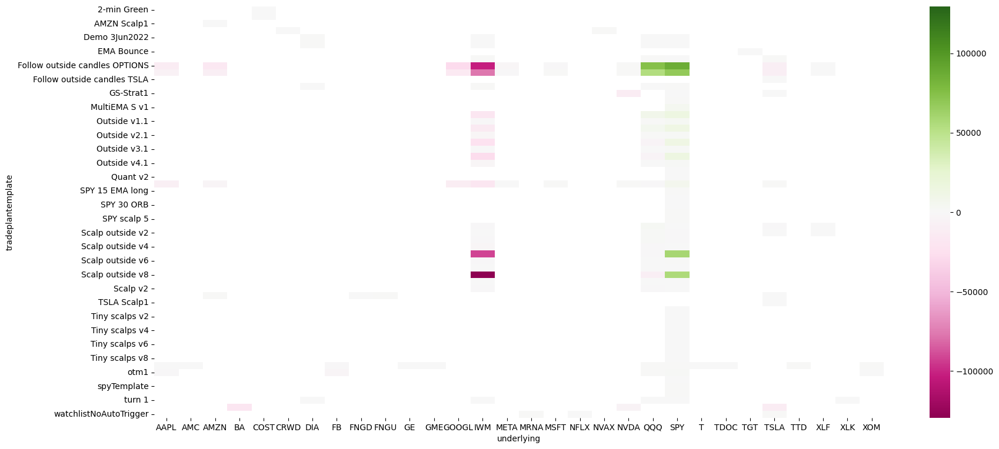

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.graph_objects as go
import plotly.express as px
import plotly.subplots as sp
import seaborn as sns
from jupyter_dash import JupyterDash
from dash import dcc
from dash import html
from dash.dependencies import Input, Output
import matplotlib.colors as mcolors
df = frame.copy()

df["entrydate"] = pd.to_datetime(df["entrydate"])
df["closedate"] = pd.to_datetime(df["closedate"])
df["day_of_trade"] = df["entrydate"].dt.date
df["day_of_trade"] = df["day_of_trade"].astype(str)
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

df['time_of_day'] = df['entrydate'].dt.time
df['time_of_day_num'] = df['time_of_day'].apply(lambda x: x.hour * 60 + x.minute)

# Here we create a figure instance, and two subplots
fig = plt.figure(figsize=(20,20))
ax1 = fig.add_subplot(211)

grouped = df.groupby(['day_of_trade', 'underlying', 'tradeplantemplate'])
piv = df.pivot_table(index='tradeplantemplate', columns='underlying', values='realizedpnl', aggfunc='sum')
print(piv)
sns.heatmap(piv, cmap='PiYG', norm=mcolors.CenteredNorm(), ax=ax1)


# PnL by Time of Day, Template, Symbol, Day, and combinations of those

In [ ]:
# multiple grouped plots

# TODO show Time-of-Day or EntryDate for each X-axis
import pandas as pd
import numpy as np
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
import plotly.graph_objects as go
import plotly.express as px
import plotly.subplots as sp
import seaborn as sns
from dash import Dash, dcc, html, jupyter_dash
from dash.dependencies import Input, Output
import datetime

# from google.colab import output
# output.serve_kernel_port_as_iframe(80)

df = frame.copy().sort_values(by='entrydate')

df["entrydate"] = pd.to_datetime(df["entrydate"])
df["closedate"] = pd.to_datetime(df["closedate"])
df["day_of_trade"] = df["entrydate"].dt.date
df["day_of_trade"] = df["day_of_trade"].astype(str)
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

df['time_of_day'] = df['entrydate'].dt.time
df['time_of_day_num'] = df['time_of_day'].apply(lambda x: x.hour * 3600 + x.minute * 60 + x.second)

#df = df[df['underlying'].isin(['SPY','QQQ', 'IWM'])][df['tradeplantemplate'].isin(['Quant v1', 'Quant v2', 'Outside v1','Outside v2','Outside v3','Outside v4'])]
#df = df[df['underlying'].isin(['SPY','QQQ', 'IWM'])]

fig = sp.make_subplots(rows=8,cols=1, shared_xaxes=False, vertical_spacing=0.02, subplot_titles=("Time of Day", "Day", "Plan", "Sym", "PlanSym", "SymDay", "PlanDay", "DaySymPlan"))

byEach = df.groupby(['day_of_trade', 'underlying', 'tradeplantemplate'])
byTimeOfDay = df.sort_values(by='time_of_day_num')
byDay = df.groupby('day_of_trade')
byTradePlan = df.groupby('tradeplantemplate')
bySymbol = df.groupby('underlying')
bySymbolDay = df.groupby(['day_of_trade', 'underlying'])
byTradePlanDay = df.groupby(['day_of_trade', 'tradeplantemplate'])
byTradePlanSymbol = df.groupby(['underlying', 'tradeplantemplate'])

# Iterate over grouped data and add subplots

tod = byTimeOfDay['time_of_day']
pnl = byTimeOfDay["realizedpnl"].cumsum()
fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", legendgroup='1'), rows=1, cols=1)

for i, (name, group) in enumerate(byDay):
    tod = group["time_of_day_num"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=name, legendgroup='2'), rows=2, cols=1)

for i, (name, group) in enumerate(byTradePlan):
    tod = group["entrydate"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=name, legendgroup='3'), rows=3, cols=1)

for i, (name, group) in enumerate(bySymbol):
    tod = group["entrydate"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=name, legendgroup='4'), rows=4, cols=1)

for i, (name, group) in enumerate(byTradePlanSymbol):
    tod = group["entrydate"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=f"{name[0]} {name[1]}", legendgroup='5'), rows=5, cols=1)

for i, (name, group) in enumerate(bySymbolDay):
    tod = group["time_of_day_num"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=f"{name[0]} {name[1]}", legendgroup='6'), rows=6, cols=1)

for i, (name, group) in enumerate(byTradePlanDay):
    tod = group["time_of_day_num"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=f"{name[0]} {name[1]}", legendgroup='7'), rows=7, cols=1)

for i, (name, group) in enumerate(byEach):
    tod = group["time_of_day_num"]
    pnl = group["realizedpnl"].cumsum()
    fig.add_traces(go.Scatter(x=tod, y=pnl, mode="lines", name=f"{name[0]} {name[1]} {name[2]}", legendgroup='8'), rows=8, cols=1)

fig.update_layout(title="Realized PnL", height=5000, legend_tracegroupgap=5000/9)

# build jupyter dash app
app = Dash(__name__)
# add html components and figure to app
app.layout = html.Div([dcc.Graph(figure=fig)])
# run app inline
app.run()

<IPython.core.display.Javascript object>

# Trading Results as Candlesticks

In [ ]:
import pandas as pd
import plotly.graph_objects as go

# Create a copy of the dataframe and sort by 'entrydate'
df = frame.copy().sort_values('entrydate')
# Add a new column 'underlying' containing the first 3 characters of the 'symbol' column
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

# Group the data by underlying, tradeplantemplate, and entrydate
grouped = df.groupby(['underlying', 'tradeplantemplate', pd.Grouper(key='entrydate', freq='D')])

# Apply the transformations within each group
daily_data = grouped.apply(lambda x: pd.Series({
    'open': x['realizedpnl'].cumsum().iloc[0],
    'high': x['realizedpnl'].cumsum().max(),
    'low': x['realizedpnl'].cumsum().min(),
    'close': x['realizedpnl'].cumsum().iloc[-1]
})).reset_index()

# Calculate the cumulative total of all trades up to the current day
daily_data['cumulative_total'] = daily_data.groupby(['underlying', 'tradeplantemplate'])['close'].cumsum()

# Iterate over each unique combination of underlying and tradeplantemplate to create a plot for each
for (underlying, tradeplantemplate), group_df in daily_data.groupby(['underlying', 'tradeplantemplate']):
    # Skip groups that have less than five candles
    #if group_df['cumulative_total'].iloc[-1] < 0 or len(group_df['cumulative_total']) < 5:
    if len(group_df['cumulative_total']) < 3:
    #if not group_df['tradeplantemplate'].str.endswith('Swing').any():
        continue

    fig = go.Figure()
    fig.add_trace(go.Candlestick(x=group_df['entrydate'],
                                 open=group_df['open'],
                                 high=group_df['high'],
                                 low=group_df['low'],
                                 close=group_df['close'],
                                 name='Daily Realized PNL'))

    fig.add_trace(go.Scatter(x=group_df['entrydate'],
                             y=group_df['cumulative_total'],
                             mode='lines',
                             line=dict(color='blue'),
                             yaxis='y2',
                             name='Cumulative Realized PNL'))

    fig.update_layout(
        title=f'{underlying} - {tradeplantemplate}',
        yaxis2=dict(title='Cumulative Realized PNL', overlaying='y', side='right'),
        yaxis=dict(title='Daily Realized PNL'),
        xaxis_title='Date',
        xaxis_rangeslider_visible=False
    )

    fig.show()


In [ ]:
# prompt: using a copy of frame, display a histogram of the number of occurrences of bucketed values of realizedpnl. Use a widget to allow the user to limit the data to a single underlying and tradePlanTemplate

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import ipywidgets as widgets
from ipywidgets import interact
from scipy.stats import skew
from scipy.stats import kurtosis

# Create a copy of the dataframe
df = frame.copy()
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

# TODO limit other dropdown to only those where there is a match - need a way to clear so you can start over

# Add '*' as an option for both dropdowns
underlying_options = ['*'] + sorted(df['underlying'].unique())
tradeplan_options = ['*'] + sorted(['Null' if pd.isna(option) else option for option in df['tradeplantemplate'].unique()])

# Create dropdowns for the selection
underlying_dropdown = widgets.Dropdown(options=underlying_options, description='Symbol:')
tradeplan_dropdown = widgets.Dropdown(options=tradeplan_options, description='Trade Plan:')
# Create an integer slider widget
integer_slider = widgets.IntSlider(
    value=25,  # Initial value
    min=1,  # Minimum value
    max=100,  # Maximum value
    step=1,  # Step size
    description='Bin Count:',  # Label for the slider
    continuous_update=True  # Update the value only when the slider is released
)

# Function to display the histogram
def display_histogram(underlying, tradeplan, bincount):
    # Filter the data based on the selected underlying and tradeplantemplate
    #mask = (df['underlying'] == underlying) & (df['tradeplantemplate'] == tradeplan)
    # mask = True  # Start with no filtering
    # Initialize the mask to include all rows
    mask = pd.Series([True] * len(df))
    if underlying_dropdown.value != '*':
        mask &= (df['underlying'] == underlying_dropdown.value)
    # map Null to NaN
    if tradeplan_dropdown.value == 'Null':  # Special handling for "Null" selection
        mask &= df['tradeplantemplate'].isna()
    elif tradeplan_dropdown.value != '*':
        mask &= (df['tradeplantemplate'] == tradeplan_dropdown.value)
    filtered_df = df.loc[mask]

    # Create a histogram of the realizedpnl values
    plt.hist(filtered_df['realizedpnl'], bins=bincount)
    plt.xlabel('Realized PnL')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of Realized PnL ({len(filtered_df)} trades)')
    plt.axvline(color='maroon', lw=0.5)
    #plt.spines['bottom'].set_position('zero')
    plt.show()
    print(filtered_df['realizedpnl'].skew(), filtered_df['realizedpnl'].kurtosis())

# Create an interactive widget to display the histogram
interact(display_histogram, underlying=underlying_dropdown, tradeplan=tradeplan_dropdown, bincount=integer_slider)


interactive(children=(Dropdown(description='Symbol:', options=('*', 'AAPL', 'AMC', 'AMD', 'AMZN', 'B', 'BA', '…

<function __main__.display_histogram(underlying, tradeplan, bincount)>

# Analysis of Trade Plan Executions

# Evaluate Transactions

# Retrieve Cumulative Results for Any Trade Plan/Symbol/Day

In [ ]:
import pandas as pd
import ipywidgets as widgets
from ipywidgets import HBox
from IPython.display import display, clear_output
import plotly.express as px
import plotly.graph_objects as go

pd.set_option('display.max_rows', None)         # Set the display option to show all rows

# Assuming 'frame' and 'extract_underlying_stock_symbol' are defined elsewhere

# Create a copy of the dataframe and sort by 'entrydate'
df = frame.copy().sort_values('entrydate')
df["underlying"] = df['symbol'].apply(lambda x: extract_underlying_stock_symbol(x))

# Add '*' as an option for both dropdowns
symbol_options = ['*'] + sorted(df['underlying'].unique())
tradeplan_options = ['*'] + sorted(['Null' if pd.isna(option) else option for option in df['tradeplantemplate'].unique()])

# Create dropdowns for the selection
symbol_dropdown = widgets.Dropdown(options=symbol_options, description='Symbol:')
tradeplan_dropdown = widgets.Dropdown(options=tradeplan_options, description='Trade Plan:')
date_dropdown = widgets.Dropdown(description='Date:')

# Create buttons
display_button = widgets.Button(description="Show Data")
clear_output_button = widgets.Button(description="Clear Output")
buttons = HBox([display_button, clear_output_button])

# Output widget to manage dynamic display of data
output_widget = widgets.Output()

# Function to update date_dropdown options based on selected underlying and tradeplantemplate
def update_dates(*args):
    # Initialize the mask to include all rows
    mask = pd.Series([True] * len(df))

    if symbol_dropdown.value != '*':
        mask &= (df['underlying'] == symbol_dropdown.value)
    # map Null to NaN
    if tradeplan_dropdown.value == 'Null':  # Special handling for "Null" selection
        mask &= df['tradeplantemplate'].isna()
    elif tradeplan_dropdown.value != '*':
        mask &= (df['tradeplantemplate'] == tradeplan_dropdown.value)

    # Apply the mask to filter the DataFrame, then get unique dates
    dates = df.loc[mask, 'entrydate'].dt.date.unique()
    date_dropdown.options = sorted(dates)

    # if dates:
        # date_dropdown.value = dates[0]  # Automatically select the first date

symbol_dropdown.observe(update_dates, 'value')
tradeplan_dropdown.observe(update_dates, 'value')

# Function to display the data for the selected day
def display_data(button):
    with output_widget:
        mask = True  # Start with no filtering
        if symbol_dropdown.value != '*':
            mask &= (df['underlying'] == symbol_dropdown.value)

        # map Null to NaN
        if tradeplan_dropdown.value == 'Null':  # Special handling for "Null" selection
            mask &= df['tradeplantemplate'].isna()
        elif tradeplan_dropdown.value != '*':
            mask &= (df['tradeplantemplate'] == tradeplan_dropdown.value)

        if date_dropdown.value is not None:
            mask &= (df['entrydate'].dt.date == date_dropdown.value)
        selected_data = df.loc[mask, ['entrydate', 'underlying', 'tradeplantemplate', 'realizedpnl']]
        selected_data['running_total'] = selected_data['realizedpnl'].cumsum()
        display(selected_data)

        # Plotly line chart for the running_total
        fig = go.Figure(data=go.Scatter(x=selected_data['entrydate'], y=selected_data['running_total'],
                                        mode='lines+markers',
                                        hoverinfo='text',
                                        text=selected_data.apply(lambda row: f"Date: {row['entrydate']}<br>Running Total: {row['running_total']}", axis=1)))
        fig.update_layout(title_text='Day\'s Running Total of Realized P&L', xaxis_title='Entry Date', yaxis_title='Running Total')

        display(fig)

# Function to clear the output
def clear_output_area(button):
    with output_widget:
        output_widget.clear_output()

display_button.on_click(display_data)
clear_output_button.on_click(clear_output_area)  # Set up the clear output button action

# Display the widgets and the output widget
display(symbol_dropdown, tradeplan_dropdown, date_dropdown, buttons, output_widget)

# Initially populate dates if both selections are '*'
update_dates()


Dropdown(description='Symbol:', options=('*', 'AAPL', 'AMC', 'AMD', 'AMZN', 'B', 'BA', 'COST', 'CRWD', 'DIA', …

Dropdown(description='Trade Plan:', options=('*', '2-min Green', '2-min Red', 'AMZN Scalp1', 'CandleMagStockLo…

Dropdown(description='Date:', options=(), value=None)

Output()